In [1]:
# --------- УПРАЖНЕНИЕ 1 --------- 

In [2]:
import numpy as np
import matplotlib.pyplot as plt

from thinkdsp import decorate

In [3]:
from thinkdsp import read_wave

wave = read_wave('res/audio/Sea_waves.wav')
wave.make_audio()

In [4]:
segment = wave.segment(start=20, duration=3.0)
segment.make_audio()

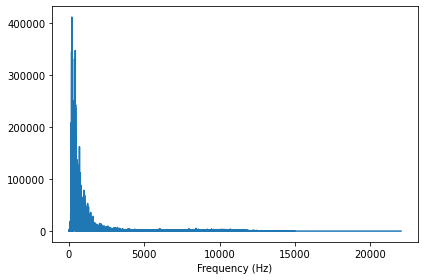

In [5]:
spectrum = segment.make_spectrum()
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)')

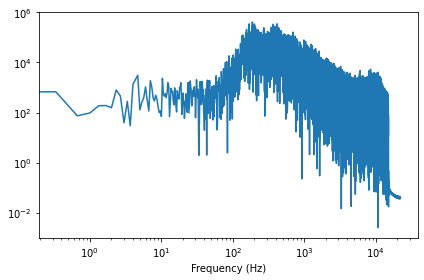

In [6]:
spectrum.plot_power()

loglog = dict(xscale='log', yscale='log')
decorate(xlabel='Frequency (Hz)', **loglog)

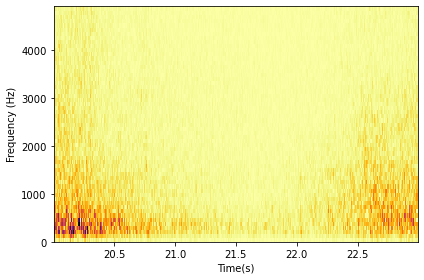

In [7]:
segment.make_spectrogram(512).plot(high=5000)
decorate(xlabel='Time(s)', ylabel='Frequency (Hz)')

In [8]:
wave = read_wave('res/audio/crickets_texas.wav')
wave.make_audio()

In [9]:
segment = wave.segment(start=20, duration=3.0)
segment.make_audio()

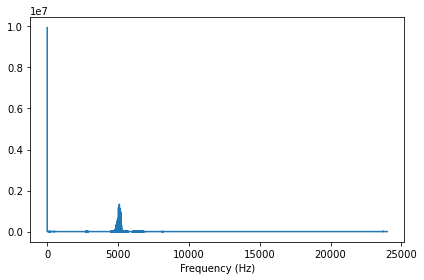

In [10]:
spectrum = segment.make_spectrum()
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)')

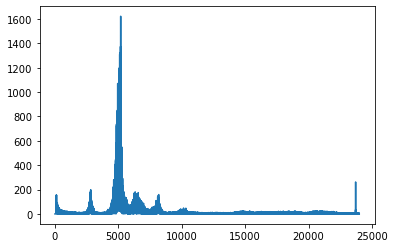

In [11]:
spectrum = wave.segment(start = 0, duration = 5).make_spectrum()
spectrum.high_pass(100)
spectrum.plot()

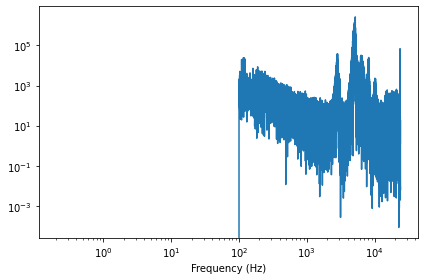

In [12]:
spectrum.plot_power()

loglog = dict(xscale='log', yscale='log')
decorate(xlabel='Frequency (Hz)', **loglog)

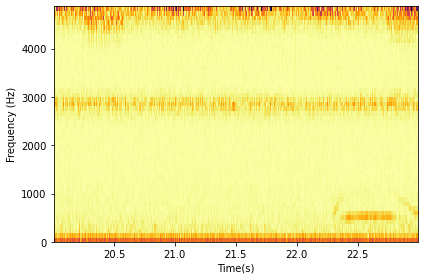

In [13]:
segment.make_spectrogram(512).plot(high=5000)
decorate(xlabel='Time(s)', ylabel='Frequency (Hz)')

In [14]:
# --------- УПРАЖНЕНИЕ 2 --------- 

In [15]:
from thinkdsp import Spectrum

def bartlett_method(wave, seg_length=512, win_flag=True):
    spectro = wave.make_spectrogram(seg_length, win_flag)
    spectrums = spectro.spec_map.values()
    
    psds = [spectrum.power for spectrum in spectrums]
    
    hs = np.sqrt(sum(psds) / len(psds))
    fs = next(iter(spectrums)).fs
    
    spectrum = Spectrum(hs, fs, wave.framerate)
    return spectrum

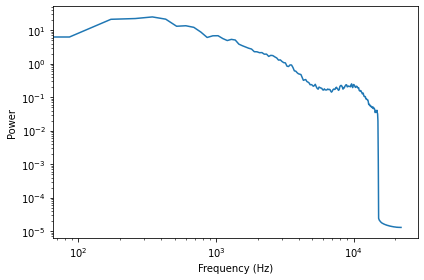

In [16]:
wave = read_wave('res/audio/Sea_waves.wav')

segment = wave.segment(start=10, duration=3.0)
segment.make_audio()

psd = bartlett_method(segment)

psd.plot_power()

decorate(xlabel='Frequency (Hz)', 
         ylabel='Power', 
         **loglog)

In [17]:
# --------- УПРАЖНЕНИЕ 3 --------- 

In [18]:
import pandas as pd

df = pd.read_csv('res/BTC_USD_2013-10-01_2021-05-05-CoinDesk.csv', 
                 parse_dates=[0])
df

,Currency,Date,Closing Price (USD),24h Open (USD),24h High (USD),24h Low (USD)
0,BTC,2013-10-01,123.654990,124.304660,124.751660,122.563490
1,BTC,2013-10-02,125.455000,123.654990,125.758500,123.633830
2,BTC,2013-10-03,108.584830,125.455000,125.665660,83.328330
3,BTC,2013-10-04,118.674660,108.584830,118.675000,107.058160
4,BTC,2013-10-05,121.338660,118.674660,121.936330,118.005660
...,...,...,...,...,...,...
2768,BTC,2021-05-01,57302.646424,53598.879503,57434.933127,53097.762794
2769,BTC,2021-05-02,57677.975222,57741.020910,58511.256049,57062.700071
2770,BTC,2021-05-03,56427.043125,57824.300187,57925.741567,56123.039508
2771,BTC,2021-05-04,57255.306838,56639.439786,59001.359642,56508.240449


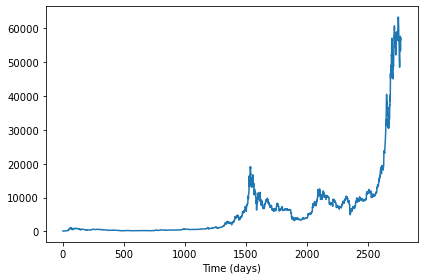

In [19]:
ys = df['Closing Price (USD)']
ts = df.index

from thinkdsp import Wave

wave = Wave(ys, ts, framerate=1)
wave.plot()
decorate(xlabel='Time (days)')

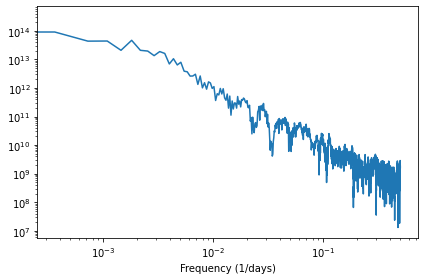

In [20]:
spectrum = wave.make_spectrum()
spectrum.plot_power()
decorate(xlabel='Frequency (1/days)', **loglog)

In [21]:
spectrum.estimate_slope()[0]

-1.8717417425660792

In [22]:
# --------- УПРАЖНЕНИЕ 4 --------- 

NameError: name 'ав' is not defined

In [23]:
from thinkdsp import Noise

class UncorrelatedPoissonNoise(Noise):

    def evaluate(self, ts):
        ys = np.random.poisson(self.amp, len(ts))
        return ys

In [49]:
amp = 0.001
framerate = 10000
duration = 1

signal = UncorrelatedPoissonNoise(amp=amp)
wave = signal.make_wave(duration=duration, framerate=framerate)
wave.make_audio()

In [50]:
expected = amp * framerate * duration
actual = sum(wave.ys)
print(expected, actual)

10.0 10


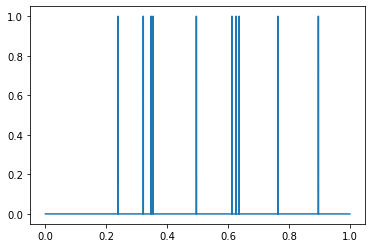

In [51]:
wave.plot()

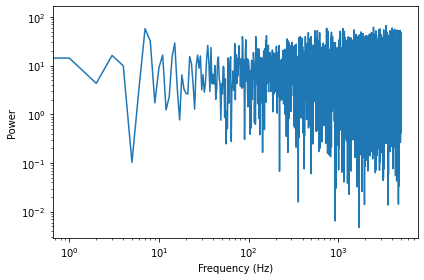

In [52]:
spectrum = wave.make_spectrum()
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)',
         ylabel='Power',
         **loglog)

In [53]:
spectrum.estimate_slope().slope

-0.0003900929448715259

In [54]:
amp = 1
framerate = 10000
duration = 1

signal = UncorrelatedPoissonNoise(amp=amp)
wave = signal.make_wave(duration=duration, framerate=framerate)
wave.make_audio()

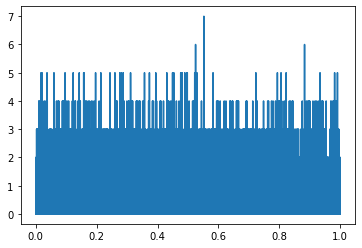

In [55]:
wave.plot()

In [56]:
import matplotlib.pyplot as plt

def normal_prob_plot(sample, fit_color='0.8', **options):
    n = len(sample)
    xs = np.random.normal(0, 1, n)
    xs.sort()
    
    ys = np.sort(sample)
    
    mean, std = np.mean(sample), np.std(sample)
    fit_ys = mean + std * xs
    plt.plot(xs, fit_ys, color='gray', alpha=0.5, label='model')

    plt.plot(xs, ys, **options)

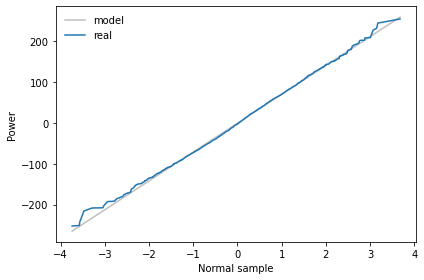

In [57]:
spectrum = wave.make_spectrum()
spectrum.hs[0] = 0

normal_prob_plot(spectrum.real, label='real')
decorate(xlabel='Normal sample',
        ylabel='Power')

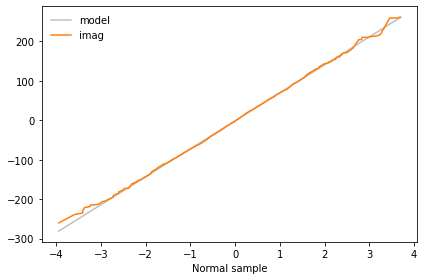

In [58]:
normal_prob_plot(spectrum.imag, label='imag', color='C1')
decorate(xlabel='Normal sample')

In [59]:
# --------- УПРАЖНЕНИЕ 5 --------- 

In [60]:
def voss(nrows, ncols=16):
    """Generates pink noise using the Voss-McCartney algorithm.
    
    nrows: number of values to generate
    rcols: number of random sources to add
    
    returns: NumPy array
    """
    array = np.empty((nrows, ncols))
    array.fill(np.nan)
    array[0, :] = np.random.random(ncols)
    array[:, 0] = np.random.random(nrows)
    
    # the total number of changes is nrows
    n = nrows
    cols = np.random.geometric(0.5, n)
    cols[cols >= ncols] = 0
    rows = np.random.randint(nrows, size=n)
    array[rows, cols] = np.random.random(n)

    df = pd.DataFrame(array)
    df.fillna(method='ffill', axis=0, inplace=True)
    total = df.sum(axis=1)

    return total.values

In [61]:
ys = voss(11025)
ys

array([7.79201163, 7.35145659, 7.20205832, ..., 9.22659538, 8.72048853,
       9.15790613])

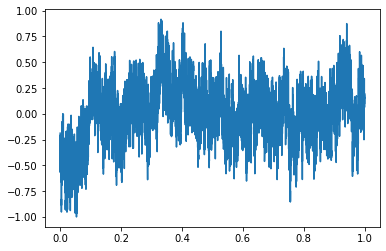

In [62]:
wave = Wave(ys)
wave.unbias()
wave.normalize()
wave.plot()

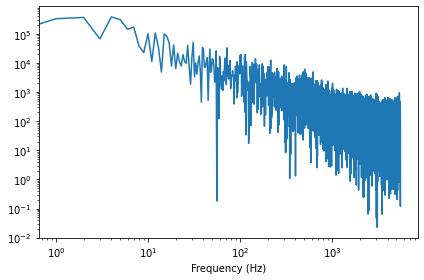

In [63]:
spectrum = wave.make_spectrum()
spectrum.hs[0] = 0
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)',
         **loglog)

In [64]:
spectrum.estimate_slope().slope

-0.9885351381362323

In [65]:
seg_length = 64 * 1024
iters = 100
wave = Wave(voss(seg_length * iters))
len(wave)

6553600

In [66]:
spectrum = bartlett_method(wave, seg_length=seg_length, win_flag=False)
spectrum.hs[0] = 0
len(spectrum)

32769

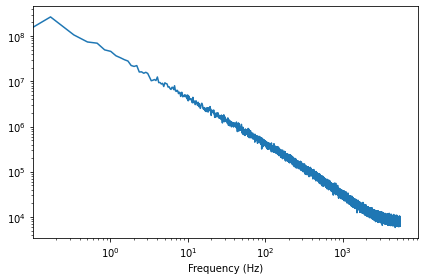

In [67]:
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)',
         **loglog)

In [68]:
spectrum.estimate_slope().slope

-1.0018254851474162